<a href="https://colab.research.google.com/github/Israelchguevara/Pump-It-Competion/blob/main/Pump_It_Up_Competion.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


**Importamos Librerias**

In [ ]:
!pip install ydata-profiling

In [ ]:
import pandas as pd
from ydata_profiling import ProfileReport
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler
from imblearn.over_sampling import SMOTE
import plotly.express as px
import plotly.graph_objects as go


**Descripción del Dataset**

* amount_tsh - Total static head (amount water available to waterpoint)
* date_recorded - The date the row was entered
* funder - Who funded the well
* gps_height - Altitude of the well
* installer - Organization that installed the well
* longitude - GPS coordinate
* latitude - GPS coordinate
* wpt_name - Name of the waterpoint if there is one
* num_private -
* basin - Geographic water basin
* subvillage - Geographic location
* region - Geographic location
* region_code - Geographic location (coded)
* district_code - Geographic location (coded)
* lga - Geographic location
* ward - Geographic location
* population - Population around the well
* public_meeting - True/False
* recorded_by - Group entering this row of data
* scheme_management - Who operates the waterpoint
* scheme_name - Who operates the waterpoint
* permit - If the waterpoint is permitted
* construction_year - Year the waterpoint was constructed
* extraction_type - The kind of extraction the waterpoint uses
* extraction_type_group - The kind of extraction the waterpoint uses
* extraction_type_class - The kind of extraction the waterpoint uses
*management - How the waterpoint is managed
*management_group - How the waterpoint is managed
* payment - What the water costs
* payment_type - What the water costs
* water_quality - The quality of the water
* quality_group - The quality of the water
* quantity - The quantity of water
* quantity_group - The quantity of water
* source - The source of the water
* source_type - The source of the water
* source_class - The source of the water
* waterpoint_type - The kind of waterpoint
* waterpoint_type_group - The kind of waterpoint




**Cargamos Dataframes**

In [ ]:
train_values = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/train_pump_it.csv')
train_labels = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/labels_pump_it.csv')
test_values = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/test.csv')

In [ ]:
# Dimensiones (número de filas y columnas) de tres DataFrames

print("Forma del conjunto de entrenamiento:", train_values.shape)
print("Forma del conjunto de etiquetas:", train_labels.shape)
print("Forma del conjunto de prueba:", test_values.shape)

Forma del conjunto de entrenamiento: (59400, 40)
Forma del conjunto de etiquetas: (59400, 2)
Forma del conjunto de prueba: (14850, 40)


In [ ]:

for i  in train_values.columns:
    print(train_values[i].value_counts())

for i in train_labels.columns:
    print(train_labels[i].value_counts())

for i in test_values.columns:
    print(test_values[i].value_counts())

id
26348    1
69572    1
8776     1
34310    1
67743    1
        ..
36957    1
50409    1
49056    1
46144    1
53934    1
Name: count, Length: 59400, dtype: int64
amount_tsh
0.00        41639
500.00       3102
50.00        2472
1000.00      1488
20.00        1463
            ...  
38000.00        1
0.25            1
12.00           1
60000.00        1
59.00           1
Name: count, Length: 98, dtype: int64
date_recorded
2011-03-15    572
2011-03-17    558
2013-02-03    546
2011-03-14    520
2011-03-16    513
             ... 
2011-09-21      1
2004-04-01      1
2011-09-26      1
2011-09-12      1
2013-12-01      1
Name: count, Length: 356, dtype: int64
funder
Government Of Tanzania    9084
Danida                    3114
Hesawa                    2202
Rwssp                     1374
World Bank                1349
                          ... 
Kauzeni                      1
Juma                         1
Banca Reale                  1
Peter Mayiro                 1
Kahema              

**Verificación de Valores Duplicados**

In [ ]:
print(train_values['id'].duplicated().value_counts())
print(train_labels['id'].duplicated().value_counts())
print(test_values['id'].duplicated().value_counts())


id
False    59400
Name: count, dtype: int64
id
False    59400
Name: count, dtype: int64
id
False    14850
Name: count, dtype: int64


**ID´s contenidos en las tablas**

In [ ]:
pd.merge(train_values, train_labels,indicator=True )['_merge'].value_counts()

,count
_merge,
both,59400
left_only,0
right_only,0


In [ ]:
print(train_values['id'].isin(train_labels['id']).value_counts())

id
True    59400
Name: count, dtype: int64


**Merge de Target**

In [ ]:
# Unir valores y etiquetas para el conjunto de entrenamiento

df_train = pd.merge(train_values,
                    train_labels,
                    how='left', on='id')

In [ ]:
df_train.head()

,id,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,...,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,status_group
0,69572,6000.0,2011-03-14,Roman,1390,Roman,34.938093,-9.856322,none,0,...,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe,functional
1,8776,0.0,2013-03-06,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,...,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,functional
2,34310,25.0,2013-02-25,Lottery Club,686,World vision,37.460664,-3.821329,Kwa Mahundi,0,...,soft,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe,functional
3,67743,0.0,2013-01-28,Unicef,263,UNICEF,38.486161,-11.155298,Zahanati Ya Nanyumbu,0,...,soft,good,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe,non functional
4,19728,0.0,2011-07-13,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,...,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,functional


**EDA  df_train**

In [ ]:
profile = ProfileReport(df_train,title="Profiling Report")

In [ ]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 41/41 [00:10<00:00,  4.03it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 59400 entries, 0 to 59399
Data columns (total 41 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   id                     59400 non-null  int64  
 1   amount_tsh             59400 non-null  float64
 2   date_recorded          59400 non-null  object 
 3   funder                 55763 non-null  object 
 4   gps_height             59400 non-null  int64  
 5   installer              55745 non-null  object 
 6   longitude              59400 non-null  float64
 7   latitude               59400 non-null  float64
 8   wpt_name               59398 non-null  object 
 9   num_private            59400 non-null  int64  
 10  basin                  59400 non-null  object 
 11  subvillage             59029 non-null  object 
 12  region                 59400 non-null  object 
 13  region_code            59400 non-null  int64  
 14  district_code          59400 non-null  int64  
 15  lg

In [ ]:
df_train.describe()

,id,amount_tsh,gps_height,longitude,latitude,num_private,region_code,district_code,population,construction_year
count,59400.000000,59400.000000,59400.000000,59400.000000,5.940000e+04,59400.000000,59400.000000,59400.000000,59400.000000,59400.000000
mean,37115.131768,317.650385,668.297239,34.077427,-5.706033e+00,0.474141,15.297003,5.629747,179.909983,1300.652475
std,21453.128371,2997.574558,693.116350,6.567432,2.946019e+00,12.236230,17.587406,9.633649,471.482176,951.620547
min,0.000000,0.000000,-90.000000,0.000000,-1.164944e+01,0.000000,1.000000,0.000000,0.000000,0.000000
25%,18519.750000,0.000000,0.000000,33.090347,-8.540621e+00,0.000000,5.000000,2.000000,0.000000,0.000000
50%,37061.500000,0.000000,369.000000,34.908743,-5.021597e+00,0.000000,12.000000,3.000000,25.000000,1986.000000
75%,55656.500000,20.000000,1319.250000,37.178387,-3.326156e+00,0.000000,17.000000,5.000000,215.000000,2004.000000
max,74247.000000,350000.000000,2770.000000,40.345193,-2.000000e-08,1776.000000,99.000000,80.000000,30500.000000,2013.000000


In [ ]:
df_train.isnull().sum()

,0
id,0
amount_tsh,0
date_recorded,0
funder,3637
gps_height,0
installer,3655
longitude,0
latitude,0
wpt_name,2
num_private,0


**Pre procesado df_train**

In [ ]:
# Identificar variables con valores nulos y su porcentaje
null_counts = df_train.isnull().sum()
null_percentages = (null_counts / len(df_train)) * 100

null_info = pd.DataFrame({
    'Null Count': null_counts,
    'Null Percentage': null_percentages
})

# Filtro para mostrar solo las columnas con valores nulos
null_info_with_nans = null_info[null_info['Null Count'] > 0].sort_values(by='Null Percentage', ascending=False)

print("Variables con valores nulos y su porcentaje en df_train:")
null_info_with_nans

Variables con valores nulos y su porcentaje en df_train:


,Null Count,Null Percentage
scheme_name,28810,48.501684
scheme_management,3878,6.528620
installer,3655,6.153199
funder,3637,6.122896
public_meeting,3334,5.612795
permit,3056,5.144781
subvillage,371,0.624579
wpt_name,2,0.003367


In [ ]:
# Identificar columnas con alta cardinalidad
high_cardinality_cols = [col for col in df_train.columns if df_train[col].dtype == 'object' and df_train[col].nunique() > 50]

print("\nColumnas con alta cardinalidad (redundantes o irrelevantes):")
print(high_cardinality_cols)


Columnas con alta cardinalidad (redundantes o irrelevantes):
['date_recorded', 'funder', 'installer', 'wpt_name', 'subvillage', 'lga', 'ward', 'scheme_name']


In [ ]:
# Eliminar columnas irrelevantes
df_train = df_train.drop(columns=['num_private'], errors='ignore')
test_values = test_values.drop(columns=['num_private'], errors='ignore')

In [ ]:
# Imputación de Valores Faltantes con Unknow
for col in ['scheme_name','funder', 'installer']:
        df_train[col] = df_train[col].fillna('unknown')
        top_n = 50 # Ajusta este número según experimentación
        top_frequent_values = df_train[col].value_counts().head(top_n).index.tolist()
        df_train[col] = df_train[col].apply(lambda x: x if x in top_frequent_values else 'other_category')

In [ ]:
# Rellenar valores nulos en 'scheme_management' con la moda
mode_scheme_management = df_train['scheme_management'].mode()[0]
df_train['scheme_management'].fillna(mode_scheme_management, inplace=True)

# Rellenar valores nulos en 'public_meeting' con la moda
mode_public_meeting = df_train['public_meeting'].mode()[0]
df_train['public_meeting'].fillna(mode_public_meeting, inplace=True)

# Rellenar valores nulos en 'permit' con la moda
mode_permit = df_train['permit'].mode()[0]
df_train['permit'].fillna(mode_permit, inplace=True)

# Verificar si quedan valores nulos en las columnas tratadas
print("\nValores nulos después del tratamiento:")
print(df_train[['scheme_name','scheme_management', 'installer', 'funder', 'public_meeting', 'permit']].isnull().sum())



Valores nulos después del tratamiento:
scheme_name          0
scheme_management    0
installer            0
funder               0
public_meeting       0
permit               0
dtype: int64


/tmp/ipython-input-66-3844027408.py:3: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_train['scheme_management'].fillna(mode_scheme_management, inplace=True)
/tmp/ipython-input-66-3844027408.py:7: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].meth

In [ ]:
# Manejo de Nulos y 0s en Numéricas
if 'gps_height' in df_train.columns:
    df_train['is_gps_height_zero'] = (df_train['gps_height'] == 0).astype(int)
    # Calculo de la media basado en valores non-zero
    median_gps_height = df_train[df_train['gps_height'] != 0]['gps_height'].median()
    df_train['gps_height'] = df_train['gps_height'].replace(0, median_gps_height)

if 'population' in df_train.columns:
    df_train['is_population_zero'] = (df_train['population'] == 0).astype(int)
    # Calculo de la media basado en valores non-zero
    median_population = df_train[df_train['population'] != 0]['population'].median()
    df_train['population'] = df_train['population'].replace(0, median_population)

if 'amount_tsh' in df_train.columns:
    df_train['is_amount_tsh_zero'] = (df_train['amount_tsh'] == 0).astype(int)
    # df_train['amount_tsh'] = df_train['amount_tsh'].apply(lambda x: np.log1p(x)) # Considerar log1p

In [ ]:
# Ingeniería de Características de Tiempo y Manejo de construction_year
if 'date_recorded' in df_train.columns:
    df_train['date_recorded'] = pd.to_datetime(df_train['date_recorded'])
    df_train['year_recorded'] = df_train['date_recorded'].dt.year
    df_train['month_recorded'] = df_train['date_recorded'].dt.month
    df_train['day_recorded'] = df_train['date_recorded'].dt.day
    df_train['day_of_week'] = df_train['date_recorded'].dt.dayofweek
    df_train = df_train.drop(columns=['date_recorded']) # Drop the original date_recorded column

if 'construction_year' in df_train.columns:
    df_train['is_construction_year_zero'] = (df_train['construction_year'] == 0).astype(int)
    # Calculo de la media basado en valores non-zero
    median_construction_year = df_train[df_train['construction_year'] != 0]['construction_year'].median()
    df_train['construction_year'] = df_train['construction_year'].replace(0, median_construction_year)
    if 'year_recorded' in df_train.columns:
        df_train['age_of_pump'] = df_train['year_recorded'] - df_train['construction_year']
        df_train['age_of_pump'] = df_train['age_of_pump'].apply(lambda x: max(0, x))

In [ ]:
# Eliminación de estas columnas demasiado ruidosas
df_train[['lga', 'ward', 'subvillage']] = df_train[['lga', 'ward', 'subvillage']].fillna('unknown')

In [ ]:
#  Manejo de Longitud/Latitud con 0s
if 'longitude' in df_train.columns:
    df_train['is_longitude_zero'] = (df_train['longitude'] == 0).astype(int)
    # Imputar 0s en longitud (que son errores para Tanzania) con la mediana
    # Se calcula la mediana excluyendo los valores 0
    median_longitude = df_train[df_train['longitude'] != 0]['longitude'].median()
    # Se reemplazan los valores 0 por la mediana calculada
    df_train['longitude'] = df_train['longitude'].replace(0, median_longitude)

if 'latitude' in df_train.columns:
    # Para la latitud, los valores cercanos a 0 pueden ser válidos,
    # pero valores exactamente 0 son errores para la ubicación en Tanzania
    # Se identifica si la latitud es 0 y se crea una nueva columna
    df_train['is_latitude_zero'] = (df_train['latitude'] == 0).astype(int)
    # Imputar 0s en latitud con la mediana de los valores non-zero
    # Se calcula la mediana excluyendo los valores 0
    median_latitude = df_train[df_train['latitude'] != 0]['latitude'].median()
    # Se reemplazan los valores 0 por la mediana calculada
    df_train['latitude'] = df_train['latitude'].replace(0, median_latitude)

# Verificar si quedan valores 0 en longitud y latitud después del tratamiento
print("\nNúmero de 0s en 'longitude' después del tratamiento:", (df_train['longitude'] == 0).sum())
print("Número de 0s en 'latitude' después del tratamiento:", (df_train['latitude'] == 0).sum())


Número de 0s en 'longitude' después del tratamiento: 0
Número de 0s en 'latitude' después del tratamiento: 0


In [ ]:
# Eliminación de Columnas Redundantes o Irrelevantes ---
columns_to_drop = [
    'wpt_name', # Identificadores y nombres
    'quantity',         # Redundante con 'quantity_group'
    'extraction_type', 'extraction_type_class', # 'extraction_type_group' suele ser suficiente
    'water_quality',    # Redundante con 'quality_group'
    'source_type', 'source_class', # 'source' suele ser suficiente
    'waterpoint_type',  # Redundante con 'waterpoint_type_group'
    'management_group'  # Redundante con 'management'
]
df_train = df_train.drop(columns=columns_to_drop, errors='ignore')

In [ ]:
# Muestra los valores Nan

print("Valores nulos después del preprocesado:")
print(df_train.isnull().sum()[df_train.isnull().sum() > 0])

Valores nulos después del preprocesado:
Series([], dtype: int64)


In [ ]:
df_train.head()

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,basin,subvillage,region,...,is_population_zero,is_amount_tsh_zero,year_recorded,month_recorded,day_recorded,day_of_week,is_construction_year_zero,age_of_pump,is_longitude_zero,is_latitude_zero
0,69572,6000.0,Roman,1390,other_category,34.938093,-9.856322,Lake Nyasa,Mnyusi B,Iringa,...,0,0,2011,3,14,0,0,12,0,0
1,8776,0.0,other_category,1399,other_category,34.698766,-2.147466,Lake Victoria,Nyamara,Mara,...,0,1,2013,3,6,2,0,3,0,0
2,34310,25.0,other_category,686,World vision,37.460664,-3.821329,Pangani,Majengo,Manyara,...,0,0,2013,2,25,0,0,4,0,0
3,67743,0.0,Unicef,263,UNICEF,38.486161,-11.155298,Ruvuma / Southern Coast,Mahakamani,Mtwara,...,0,1,2013,1,28,0,0,27,0,0
4,19728,0.0,other_category,1167,other_category,31.130847,-1.825359,Lake Victoria,Kyanyamisa,Kagera,...,1,1,2011,7,13,2,1,11,0,0


**EDA test_values**

In [ ]:
profile = ProfileReport(test_values,title="Profiling Report")

In [ ]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 39/39 [00:03<00:00, 10.01it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
test_values.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14850 entries, 0 to 14849
Data columns (total 39 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   id                     14850 non-null  int64  
 1   amount_tsh             14850 non-null  float64
 2   date_recorded          14850 non-null  object 
 3   funder                 13980 non-null  object 
 4   gps_height             14850 non-null  int64  
 5   installer              13973 non-null  object 
 6   longitude              14850 non-null  float64
 7   latitude               14850 non-null  float64
 8   wpt_name               14850 non-null  object 
 9   basin                  14850 non-null  object 
 10  subvillage             14751 non-null  object 
 11  region                 14850 non-null  object 
 12  region_code            14850 non-null  int64  
 13  district_code          14850 non-null  int64  
 14  lga                    14850 non-null  object 
 15  wa

In [ ]:
test_values.describe()

,id,amount_tsh,gps_height,longitude,latitude,region_code,district_code,population,construction_year
count,14850.000000,14850.000000,14850.000000,14850.000000,1.485000e+04,14850.000000,14850.000000,14850.000000,14850.000000
mean,37161.972929,322.826983,655.147609,34.061605,-5.684724e+00,15.139057,5.626397,184.114209,1289.708350
std,21359.364833,2510.968644,691.261185,6.593034,2.940803e+00,17.191329,9.673842,469.499332,955.241087
min,10.000000,0.000000,-57.000000,0.000000,-1.156459e+01,1.000000,0.000000,0.000000,0.000000
25%,18727.000000,0.000000,0.000000,33.069455,-8.443970e+00,5.000000,2.000000,0.000000,0.000000
50%,37361.500000,0.000000,344.000000,34.901215,-5.049750e+00,12.000000,3.000000,20.000000,1986.000000
75%,55799.750000,25.000000,1308.000000,37.196594,-3.320594e+00,17.000000,5.000000,220.000000,2004.000000
max,74249.000000,200000.000000,2777.000000,40.325016,-2.000000e-08,99.000000,80.000000,11469.000000,2013.000000


**Pre procesado test_values**

In [ ]:
# Identificar variables con valores nulos y su porcentaje
null_counts_test = test_values.isnull().sum()
null_percentages_test = (null_counts_test / len(test_values)) * 100

null_info_test = pd.DataFrame({
    'Null Count': null_counts_test,
    'Null Percentage': null_percentages_test
})

# Filtro para mostrar solo las columnas con valores nulos
null_info_with_nans_test = null_info_test[null_info_test['Null Count'] > 0].sort_values(by='Null Percentage', ascending=False)

print("Variables con valores nulos y su porcentaje en test_values:")
null_info_with_nans_test


Variables con valores nulos y su porcentaje en test_values:


,Null Count,Null Percentage
scheme_name,7242,48.767677
scheme_management,969,6.525253
installer,877,5.905724
funder,870,5.858586
public_meeting,821,5.528620
permit,737,4.962963
subvillage,99,0.666667


In [ ]:
# Identificar columnas con alta cardinalidad
high_cardinality_cols_test = [col for col in test_values.columns if test_values[col].dtype == 'object' and test_values[col].nunique() > 50]

print("\nColumnas con alta cardinalidad (redundantes o irrelevantes) en test_values:")
print(high_cardinality_cols_test)


Columnas con alta cardinalidad (redundantes o irrelevantes) en test_values:
['date_recorded', 'funder', 'installer', 'wpt_name', 'subvillage', 'lga', 'ward', 'scheme_name']


In [ ]:
# Imputación de Valores Faltantes con Unknow en test_values
for col in ['scheme_name','funder', 'installer']:
        test_values[col] = test_values[col].fillna('unknown')

        # Reutilizar los top_frequent_values calculados en el df_train
        top_frequent_values_train = df_train[col].value_counts().head(50).index.tolist()
        if 'other_category' not in top_frequent_values_train:
            top_frequent_values_train.append('other_category')

        test_values[col] = test_values[col].apply(lambda x: x if x in top_frequent_values_train else 'other_category')

In [ ]:
# Rellenar valores nulos en 'scheme_management' con la moda del train_values
mode_scheme_management_train = df_train['scheme_management'].mode()[0]
test_values['scheme_management'].fillna(mode_scheme_management_train, inplace=True)

# Rellenar valores nulos en 'public_meeting' con la moda del train_values
mode_public_meeting_train = df_train['public_meeting'].mode()[0]
test_values['public_meeting'].fillna(mode_public_meeting_train, inplace=True)

# Rellenar valores nulos en 'permit' con la moda del train_values
mode_permit_train = df_train['permit'].mode()[0]
test_values['permit'].fillna(mode_permit_train, inplace=True)

# Verificar si quedan valores nulos en las columnas tratadas
print("\nValores nulos después del tratamiento en test_values:")
print(test_values[['scheme_name', 'scheme_management', 'installer', 'funder', 'public_meeting', 'permit']].isnull().sum())


Valores nulos después del tratamiento en test_values:
scheme_name          0
scheme_management    0
installer            0
funder               0
public_meeting       0
permit               0
dtype: int64


/tmp/ipython-input-81-2453206092.py:3: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  test_values['scheme_management'].fillna(mode_scheme_management_train, inplace=True)
/tmp/ipython-input-81-2453206092.py:7: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[

In [ ]:
# Manejo de Nulos y 0s en Numéricas en test_values
if 'gps_height' in test_values.columns:
    test_values['is_gps_height_zero'] = (test_values['gps_height'] == 0).astype(int)
    # Usar la mediana calculada del df_train
    test_values['gps_height'] = test_values['gps_height'].replace(0, median_gps_height)

if 'population' in test_values.columns:
    test_values['is_population_zero'] = (test_values['population'] == 0).astype(int)
    # Usar la mediana calculada del df_train
    test_values['population'] = test_values['population'].replace(0, median_population)

if 'amount_tsh' in test_values.columns:
    test_values['is_amount_tsh_zero'] = (test_values['amount_tsh'] == 0).astype(int)
    # test_values['amount_tsh'] = test_values['amount_tsh'].apply(lambda x: np.log1p(x)) # Considerar log1p si se aplicó en train

In [ ]:
# Ingeniería de Características de Tiempo y Manejo de construction_year en test_values
if 'date_recorded' in test_values.columns:
    test_values['date_recorded'] = pd.to_datetime(test_values['date_recorded'])
    test_values['year_recorded'] = test_values['date_recorded'].dt.year
    test_values['month_recorded'] = test_values['date_recorded'].dt.month
    test_values['day_recorded'] = test_values['date_recorded'].dt.day
    test_values['day_of_week'] = test_values['date_recorded'].dt.dayofweek
    test_values = test_values.drop(columns=['date_recorded']) # Drop the original date_recorded column

if 'construction_year' in test_values.columns:
    test_values['is_construction_year_zero'] = (test_values['construction_year'] == 0).astype(int)
    # Usar la mediana calculada del df_train
    test_values['construction_year'] = test_values['construction_year'].replace(0, median_construction_year)
    if 'year_recorded' in test_values.columns:
        test_values['age_of_pump'] = test_values['year_recorded'] - test_values['construction_year']
        test_values['age_of_pump'] = test_values['age_of_pump'].apply(lambda x: max(0, x))

In [ ]:
# Eliminación de estas columnas demasiado ruidosas en test_values
test_values[['lga', 'ward', 'subvillage']] = test_values[['lga', 'ward', 'subvillage']].fillna('unknown')

#  Manejo de Longitud/Latitud con 0s en test_values
if 'longitude' in test_values.columns:
    test_values['is_longitude_zero'] = (test_values['longitude'] == 0).astype(int)
    # Usar la mediana calculada del df_train
    test_values['longitude'] = test_values['longitude'].replace(0, median_longitude)

if 'latitude' in test_values.columns:
    test_values['is_latitude_zero'] = (test_values['latitude'] == 0).astype(int)
    # Usar la mediana calculada del df_train
    test_values['latitude'] = test_values['latitude'].replace(0, median_latitude)

# Verificar si quedan valores 0 en longitud y latitud después del tratamiento
print("\nNúmero de 0s en 'longitude' después del tratamiento en test_values:", (test_values['longitude'] == 0).sum())
print("Número de 0s en 'latitude' después del tratamiento en test_values:", (test_values['latitude'] == 0).sum())



Número de 0s en 'longitude' después del tratamiento en test_values: 0
Número de 0s en 'latitude' después del tratamiento en test_values: 0


In [ ]:
# Eliminación de Columnas Redundantes o Irrelevantes en test_values ---
test_values = test_values.drop(columns=columns_to_drop, errors='ignore')

print("\nValores nulos después del preprocesado en test_values:")
print(test_values.isnull().sum()[test_values.isnull().sum() > 0])


Valores nulos después del preprocesado en test_values:
Series([], dtype: int64)


In [ ]:
test_values.head()

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,basin,subvillage,region,...,is_population_zero,is_amount_tsh_zero,year_recorded,month_recorded,day_recorded,day_of_week,is_construction_year_zero,age_of_pump,is_longitude_zero,is_latitude_zero
0,50785,0.0,Dmdd,1996,other_category,35.290799,-4.059696,Internal,Magoma,Manyara,...,0,1,2013,2,4,0,0,1,0,0
1,51630,0.0,Government Of Tanzania,1569,DWE,36.656709,-3.309214,Pangani,Kimnyak,Arusha,...,0,1,2013,2,4,0,0,13,0,0
2,17168,0.0,unknown,1567,unknown,34.767863,-5.004344,Internal,Msatu,Singida,...,0,1,2013,2,1,4,0,3,0,0
3,45559,0.0,other_category,267,other_category,38.058046,-9.418672,Ruvuma / Southern Coast,Kipindimbi,Lindi,...,0,1,2013,1,22,1,0,26,0,0
4,49871,500.0,other_category,1260,other_category,35.006123,-10.950412,Ruvuma / Southern Coast,Losonga,Ruvuma,...,0,0,2013,3,27,2,0,13,0,0


In [ ]:
df_train.head()

,id,amount_tsh,funder,gps_height,installer,longitude,latitude,basin,subvillage,region,...,is_population_zero,is_amount_tsh_zero,year_recorded,month_recorded,day_recorded,day_of_week,is_construction_year_zero,age_of_pump,is_longitude_zero,is_latitude_zero
0,69572,6000.0,Roman,1390,other_category,34.938093,-9.856322,Lake Nyasa,Mnyusi B,Iringa,...,0,0,2011,3,14,0,0,12,0,0
1,8776,0.0,other_category,1399,other_category,34.698766,-2.147466,Lake Victoria,Nyamara,Mara,...,0,1,2013,3,6,2,0,3,0,0
2,34310,25.0,other_category,686,World vision,37.460664,-3.821329,Pangani,Majengo,Manyara,...,0,0,2013,2,25,0,0,4,0,0
3,67743,0.0,Unicef,263,UNICEF,38.486161,-11.155298,Ruvuma / Southern Coast,Mahakamani,Mtwara,...,0,1,2013,1,28,0,0,27,0,0
4,19728,0.0,other_category,1167,other_category,31.130847,-1.825359,Lake Victoria,Kyanyamisa,Kagera,...,1,1,2011,7,13,2,1,11,0,0


In [ ]:
# Preparación del Pipeline de Preprocesamiento y División de Datos

!pip install lightgbm
import lightgbm as lgb
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.model_selection import train_test_split # Import train_test_split

# Eliminar la columna 'id' ya que no es una característica para el modelo
X = df_train.drop(columns=['status_group', 'id'])
y = df_train['status_group']

# Identificar columnas categóricas y numéricas (re-evaluar si se añadieron o quitaron)
categorical_features = X.select_dtypes(include=['object', 'bool']).columns
numeric_features = X.select_dtypes(include=np.number).columns

# Crear el pipeline de preprocesamiento para características numéricas
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])

# Para LightGBM, se pueden usar One-Hot Encoding o que maneje directamente categóricas.

categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore')) # handle_unknown='ignore' crucial
])

# Combinar los transformadores usando ColumnTransformer
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ],
    remainder='passthrough' # Mantener otras columnas si las hay (aunque con drop inicial no debería)
)

# Dividir los datos en conjuntos de entrenamiento y validación
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Definir el modelo LightGBM
# Usamos objective='multiclass' ya que tenemos 3 clases.
# num_class=3 porque hay 3 estados posibles.
# boosting_type='gbdt' (Gradient Boosting Decision Tree) es el predeterminado y común.
model_lgbm = lgb.LGBMClassifier(objective='multiclass', num_class=3, random_state=42, n_jobs=-1)

# Crear el pipeline completo incluyendo preprocesamiento y modelo LightGBM
full_pipeline_lgbm = Pipeline(steps=[('preprocessor', preprocessor),
                                       ('classifier', model_lgbm)])


In [ ]:
# Entrenar el modelo LightGBM
# LightGBM puede manejar mejor los datos transformados si le pasamos los nombres de las columnas
# categóricas originales antes del OHE, pero con el pipeline de preprocesamiento,
# el OHE se aplica internamente. Entrenamos el pipeline completo.
full_pipeline_lgbm.fit(X_train, y_train)

# Crear el archivo de submission para LightGBM
# Hacer predicciones en el conjunto de prueba
test_ids = test_values['id']
X_test = test_values.drop(columns=['id'])

# Alinear las columnas de X_test con las de X_train antes de la transformación
X_test_aligned, X_train_aligned = X_test.align(X_train, join='inner', axis=1)

test_predictions_lgbm = full_pipeline_lgbm.predict(X_test_aligned)
submission_df_lgbm = pd.DataFrame({'id': test_ids, 'status_group': test_predictions_lgbm})

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 1.635445 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4206
[LightGBM] [Info] Number of data points in the train set: 47520, number of used features: 1461
[LightGBM] [Info] Start training from score -0.610505
[LightGBM] [Info] Start training from score -2.621618
[LightGBM] [Info] Start training from score -0.956493


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


In [ ]:
# Guardar el archivo de submission
submission_df_lgbm.to_csv('submission_lgbm.csv', index=False)

print(submission_df_lgbm.head())

      id    status_group
0  50785      functional
1  51630      functional
2  17168      functional
3  45559  non functional
4  49871      functional


In [ ]:
# prompt: descargar el archivo en csv

from google.colab import files
files.download('submission_lgbm.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

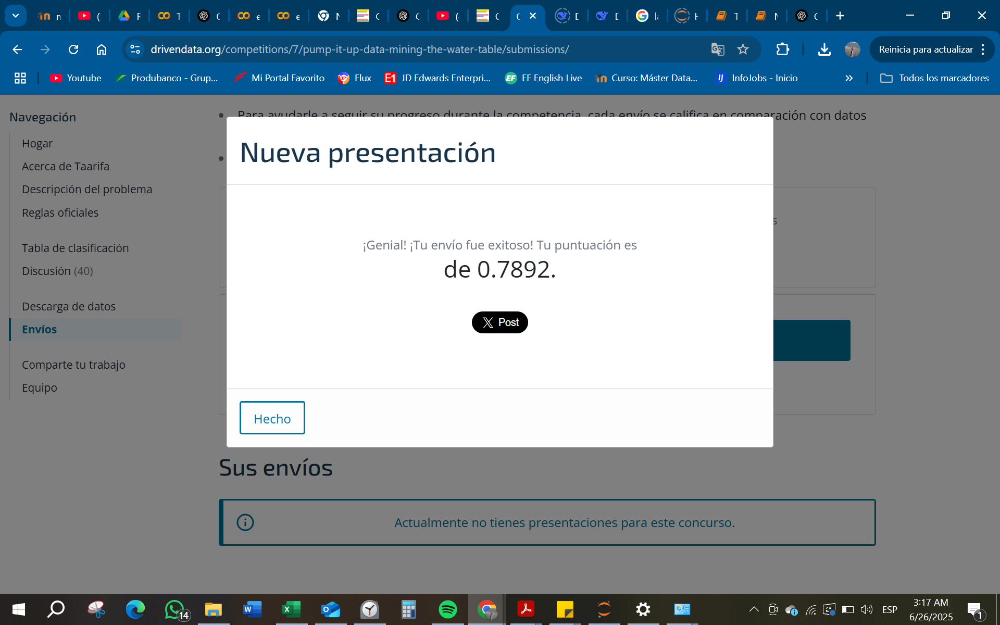